<a href="https://colab.research.google.com/github/tanhtanh1505/kilo-nerf/blob/main/kilonerf.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import numpy as np
from tqdm import tqdm
import torch.nn as nn
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Hyper parameter

In [ ]:
user = 86

In [ ]:
train_data_path = '/content/drive/MyDrive/nerf_datasets/training_data.pkl' if user == 86 else '/content/drive/MyDrive/Tài liệu/Năm 3/Kỳ 2/Chuyên đề Công nghệ/Cuối kỳ/kilo nerf/nerf_datasets/training_data.pkl'
test_data_path = '/content/drive/MyDrive/nerf_datasets/testing_data.pkl' if user == 86 else '/content/drive/MyDrive/Tài liệu/Năm 3/Kỳ 2/Chuyên đề Công nghệ/Cuối kỳ/kilo nerf/nerf_datasets/testing_data.pkl'
model_path = '/content/drive/MyDrive/Chuyên đề Công nghệ/Cuối kỳ/kilo nerf/Model/kilonerf.pth' if user == 86 else '/content/drive/MyDrive/Tài liệu/Năm 3/Kỳ 2/Chuyên đề Công nghệ/Cuối kỳ/kilo nerf/Model/kilonerf.pth'
output_path = '/content/drive/MyDrive/Chuyên đề Công nghệ/Cuối kỳ/kilo nerf/Output/' if user == 86 else '/content/drive/MyDrive/Tài liệu/Năm 3/Kỳ 2/Chuyên đề Công nghệ/Cuối kỳ/kilo nerf/Data/Kilo_out_10/'

device = 'cuda' if torch.cuda.is_available() else 'cpu'
training_dataset = torch.from_numpy(np.load(train_data_path, allow_pickle=True))
train_data_loader = DataLoader(training_dataset, batch_size=2048, shuffle=True)

# Setup

In [ ]:
class KiloNerf(nn.Module):
  # N is the size of each side of the grid of the voxel or where we will store the MLPs on
  # as a usual with Nerf we use a positional encoding on we have the maximum frequency for the position on the maximum frequency for the direction
    def __init__(self, N, embedding_dim_pos=10, embedding_dim_direction=4, scene_scale=3):
        super(KiloNerf, self).__init__()

        # KiloNerf with Xavier initialization
        self.layer1_w = torch.nn.Parameter(torch.zeros((N, N, N, 63, 32)).uniform_(-np.sqrt(6. / 85), np.sqrt(6. / 85)))
        self.layer1_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 32)))
        self.layer2_w = torch.nn.Parameter(torch.zeros((N, N, N, 32, 33)).uniform_(-np.sqrt(6. / 64), np.sqrt(6. / 64)))
        self.layer2_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 33)))
        self.layer3_w = torch.nn.Parameter(torch.zeros((N, N, N, 32, 32)).uniform_(-np.sqrt(6. / 64), np.sqrt(6. / 64)))
        self.layer3_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 32)))
        self.layer4_w = torch.nn.Parameter(
            torch.zeros((N, N, N, 27 + 32, 32)).uniform_(-np.sqrt(6. / 64), np.sqrt(6. / 64)))
        self.layer4_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 32)))
        self.layer5_w = torch.nn.Parameter(torch.zeros((N, N, N, 32, 3)).uniform_(-np.sqrt(6. / 35), np.sqrt(6. / 35)))
        self.layer5_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 3)))

        self.embedding_dim_pos = embedding_dim_pos
        self.embedding_dim_direction = embedding_dim_direction
        self.N = N
        self.scale = scene_scale

    @staticmethod
    def positional_encoding(x, L):
        out = [x]
        for j in range(L):
            out.append(torch.sin(2 ** j * x))
            out.append(torch.cos(2 ** j * x))
        return torch.cat(out, dim=1)

    def forward(self, x, d):
        color = torch.zeros_like(x)
        sigma = torch.zeros((x.shape[0]), device=x.device)

        mask = (x[:, 0].abs() < (self.scale / 2)) & (x[:, 1].abs() < (self.scale / 2)) & (
                x[:, 2].abs() < (self.scale / 2))
        idx = (x[mask] / (self.scale / self.N) + self.N / 2).long().clip(0, self.N - 1)

        emb_x = self.positional_encoding(x[mask], self.embedding_dim_pos)
        emb_d = self.positional_encoding(d[mask], self.embedding_dim_direction)

        # Implementation of the MLP architecture from Figure 2
        h = torch.relu(emb_x.unsqueeze(1) @ self.layer1_w[idx[:, 0], idx[:, 1], idx[:, 2]] + \
                       self.layer1_b[idx[:, 0], idx[:, 1], idx[:, 2]])
        h = torch.relu(h @ self.layer2_w[idx[:, 0], idx[:, 1], idx[:, 2]] + self.layer2_b[idx[:, 0], idx[:, 1],
                                                                                          idx[:, 2]])
        h, density = h[:, :, :-1], h[:, :, -1]
        h = h @ self.layer3_w[idx[:, 0], idx[:, 1], idx[:, 2]] + self.layer3_b[idx[:, 0], idx[:, 1], idx[:, 2]]
        h = torch.relu(torch.cat((h, emb_d.unsqueeze(1)), dim=-1) @ self.layer4_w[idx[:, 0], idx[:, 1], idx[:, 2]] + \
                       self.layer4_b[idx[:, 0], idx[:, 1], idx[:, 2]])
        c = torch.sigmoid(h @ self.layer5_w[idx[:, 0], idx[:, 1], idx[:, 2]] + self.layer5_b[idx[:, 0], idx[:, 1],
                                                                                             idx[:, 2]])
        color[mask] = c.squeeze(1)
        sigma[mask] = density.squeeze(1)
        return color, sigma

In [ ]:
@torch.no_grad()
def test(hn, hf, dataset, model, device, chunk_size=5, img_index=0, nb_bins=192, H=400, W=400):
    ray_origins = dataset[img_index * H * W: (img_index + 1) * H * W, :3]
    ray_directions = dataset[img_index * H * W: (img_index + 1) * H * W, 3:6]

    data = []
    for i in range(int(np.ceil(H / chunk_size))):
        ray_origins_ = ray_origins[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        ray_directions_ = ray_directions[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        regenerated_px_values = render_rays(model, ray_origins_, ray_directions_, hn=hn, hf=hf, nb_bins=nb_bins)
        data.append(regenerated_px_values)
    img = torch.cat(data).data.cpu().numpy().reshape(H, W, 3)

    plt.figure()
    plt.imshow(img)
    plt.axis('off')
    plt.savefig(f'{output_path}img_{img_index}.png', bbox_inches='tight')
    plt.show()


def compute_accumulated_transmittance(alphas):
    accumulated_transmittance = torch.cumprod(alphas, 1)
    return torch.cat((torch.ones((accumulated_transmittance.shape[0], 1), device=alphas.device),
                      accumulated_transmittance[:, :-1]), dim=-1)


def render_rays(nerf_model, ray_origins, ray_directions, hn=0, hf=0.5, nb_bins=192):
    device = ray_origins.device
    t = torch.linspace(hn, hf, nb_bins, device=device).expand(ray_origins.shape[0], nb_bins)
    # Perturb sampling along each ray.
    mid = (t[:, :-1] + t[:, 1:]) / 2.
    lower = torch.cat((t[:, :1], mid), -1)
    upper = torch.cat((mid, t[:, -1:]), -1)
    u = torch.rand(t.shape, device=device)
    t = lower + (upper - lower) * u  # [batch_size, nb_bins]
    delta = torch.cat((t[:, 1:] - t[:, :-1], torch.tensor([1e10], device=device).expand(ray_origins.shape[0], 1)), -1)

    x = ray_origins.unsqueeze(1) + t.unsqueeze(2) * ray_directions.unsqueeze(1)  # [batch_size, nb_bins, 3]
    ray_directions = ray_directions.expand(nb_bins, ray_directions.shape[0], 3).transpose(0, 1)

    colors, sigma = nerf_model(x.reshape(-1, 3), ray_directions.reshape(-1, 3))
    colors = colors.reshape(x.shape)
    sigma = sigma.reshape(x.shape[:-1])

    alpha = 1 - torch.exp(-sigma * delta)  # [batch_size, nb_bins]
    weights = compute_accumulated_transmittance(1 - alpha).unsqueeze(2) * alpha.unsqueeze(2)
    c = (weights * colors).sum(dim=1)  # Pixel values
    # Regularization for white background
    weight_sum = weights.sum(-1).sum(-1)
    return c + 1 - weight_sum.unsqueeze(-1)


def save_model(model):
    torch.save(model, model_path)


def train(nerf_model, optimizer, scheduler, data_loader, device='cpu', hn=0, hf=1, nb_epochs=int(1e5), nb_bins=192):
    training_loss = []
    for _ in (range(nb_epochs)):
        for ep, batch in enumerate(tqdm(data_loader)):
            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions, hn=hn, hf=hf, nb_bins=nb_bins)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).sum()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            training_loss.append(loss.item())
        scheduler.step()
        save_model(model)
    return training_loss


# Train

In [ ]:
# model = KiloNerf(N=16).to(device)
model = torch.load(model_path)
model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
scheduler = torch.optim.lr_scheduler.MultiStepLR(model_optimizer, milestones=[2, 4, 8], gamma=0.5)

In [ ]:
train(model, model_optimizer, scheduler, train_data_loader, nb_epochs=10, device=device, hn=2, hf=6, nb_bins=192)

 12%|█▏        | 919/7813 [03:58<29:34,  3.88it/s]

# Test

In [ ]:
testing_dataset = torch.from_numpy(np.load(test_data_path, allow_pickle=True))
model = torch.load(model_path)

In [ ]:
# for idx in range(200):
#   test(2, 6, testing_dataset, model, device, img_index=idx, nb_bins=192, H=400, W=400)

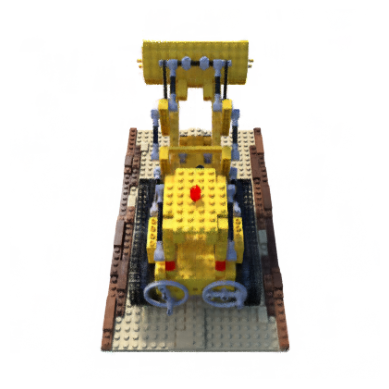

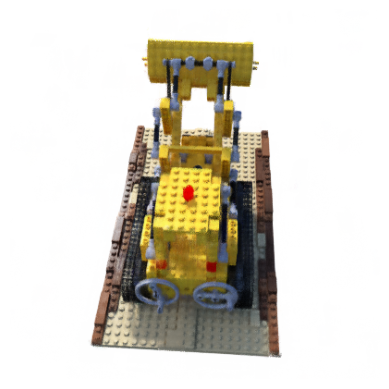

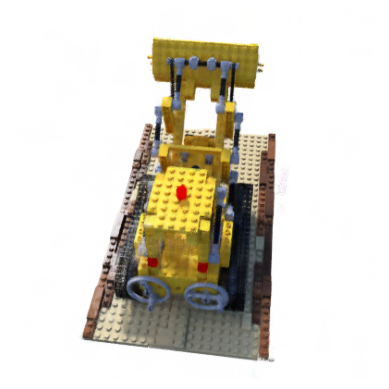

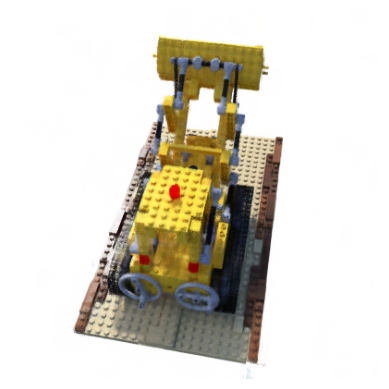

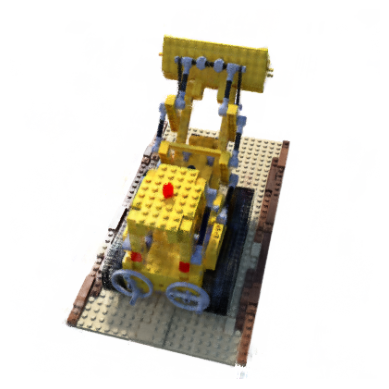

...

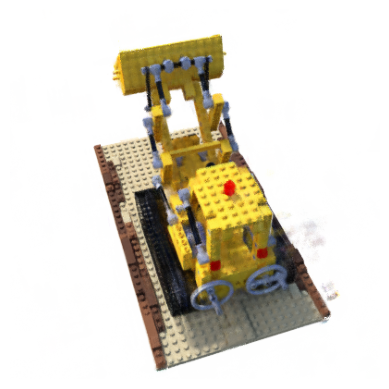

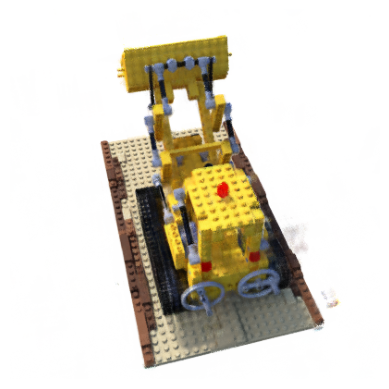

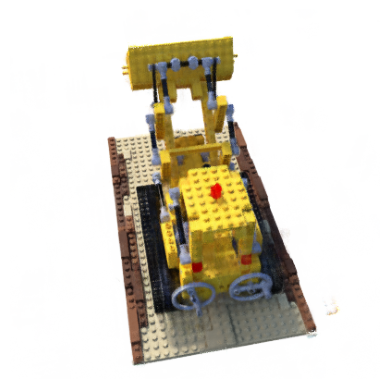

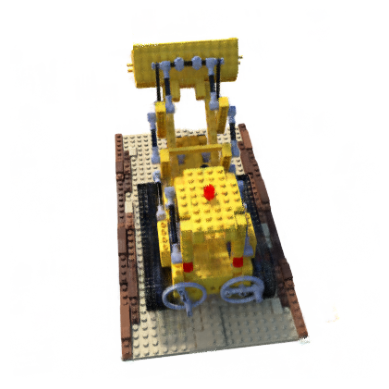

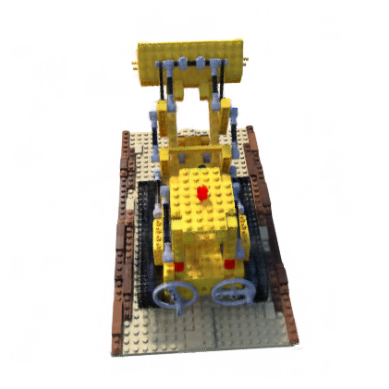

In [ ]:
for idx in range(200):
  test(2, 6, testing_dataset, model, device, img_index=idx, nb_bins=192, H=400, W=400)